In [2]:
from bs4 import BeautifulSoup
import pandas as pd
import urllib.request  as urllib2 
import numpy as np

from nltk.tokenize import RegexpTokenizer
from gensim import corpora, models
import gensim



In [3]:
# Read data.

import os

# Folder containing all NIPS papers.
data_dir = 'nipstxt/'

# Folders containin individual NIPS papers.
yrs = ['00', '01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12']
dirs = ['nips' + yr for yr in yrs]

# Read all texts into a list.
docs = []
for yr_dir in dirs:
    files = os.listdir(data_dir + yr_dir)
    for filen in files:
        # Note: ignoring characters that cause encoding errors.
        with open(data_dir + yr_dir + '/' + filen, errors='ignore') as fid:
            txt = fid.read()
        docs.append(txt)

In [4]:
## Natural Language Processing 

In [5]:
from sklearn.feature_extraction.stop_words import ENGLISH_STOP_WORDS
from nltk.tokenize import RegexpTokenizer
from nltk.stem.wordnet import WordNetLemmatizer
from sklearn.feature_extraction.text import CountVectorizer,TfidfVectorizer
import re


In [6]:
docs[:10]

['1 \nCONNECTIVITY VERSUS ENTROPY \nYaser S. Abu-Mostafa \nCalifornia Institute of Technology \nPasadena, CA 91125 \nABSTRACT \nHow does the connectivity of a neural network (number of synapses per \nneuron) relate to the complexity of the problems it can handle (measured by \nthe entropy)? Switching theory would suggest no relation at all, since all Boolean \nfunctions can be implemented using a circuit with very low connectivity (e.g., \nusing two-input NAND gates). However, for a network that learns a problem \nfrom examples using a local learning rule, we prove that the entropy of the \nproblem becomes a lower bound for the connectivity of the network. \nINTRODUCTION \nThe most distinguishing feature of neural networks is their ability to spon- \ntaneously learn the desired function from \'training\' samples, i.e., their ability \nto program themselves. Clearly, a given neural network cannot just learn any \nfunction, there must be some restrictions on which networks can learn whic

In [7]:
# Split the documents into tokens.
#tokenisation
import string
from nltk.corpus import stopwords
stop_words = set(stopwords.words('english'))

tokenizer = RegexpTokenizer(r'\w+')
for idx in range(len(docs)):
    docs[idx] = docs[idx].lower()  # Convert to lowercase.
    docs[idx] = tokenizer.tokenize(docs[idx])  # Split into words.


docs = [[token for token in doc if not token.isnumeric()] for doc in docs]

# Remove words that are only one character.
docs = [[token for token in doc if len(token) > 3] for doc in docs]
# Remove stopwords
docs=[[token for token in doc if not token in stop_words] for doc in docs]

# prepare regex for char filtering
re_punc = re.compile('[%s]' % re.escape(string.punctuation))


# remove punctuation from each word
docs = [[re_punc.sub('', token) for token in doc] for doc in docs]

# remove remaining tokens that are not alphabetic
docs = [[word for word in doc if  word.isalpha()] for doc in docs]


In [8]:
import nltk
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/giwrgosyea/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [9]:
# Lemmatize all words in documents.
lemmatizer = WordNetLemmatizer()
docs = [[lemmatizer.lemmatize(token) for token in doc] for doc in docs]

In [10]:
docs[:10]

[['connectivity',
  'versus',
  'entropy',
  'yaser',
  'mostafa',
  'california',
  'institute',
  'technology',
  'pasadena',
  'abstract',
  'connectivity',
  'neural',
  'network',
  'number',
  'synapsis',
  'neuron',
  'relate',
  'complexity',
  'problem',
  'handle',
  'measured',
  'entropy',
  'switching',
  'theory',
  'would',
  'suggest',
  'relation',
  'since',
  'boolean',
  'function',
  'implemented',
  'using',
  'circuit',
  'connectivity',
  'using',
  'input',
  'nand',
  'gate',
  'however',
  'network',
  'learns',
  'problem',
  'example',
  'using',
  'local',
  'learning',
  'rule',
  'prove',
  'entropy',
  'problem',
  'becomes',
  'lower',
  'bound',
  'connectivity',
  'network',
  'introduction',
  'distinguishing',
  'feature',
  'neural',
  'network',
  'ability',
  'spon',
  'taneously',
  'learn',
  'desired',
  'function',
  'training',
  'sample',
  'ability',
  'program',
  'clearly',
  'given',
  'neural',
  'network',
  'cannot',
  'learn',
  'f

In [11]:
from  collections  import Counter
import itertools

vocabulary = Counter()
for tweet_tokens in itertools.chain(docs):
    vocabulary.update(tweet_tokens)

vocabulary.most_common(10)

[('network', 31400),
 ('model', 22033),
 ('learning', 18454),
 ('function', 17150),
 ('input', 16963),
 ('neural', 15023),
 ('time', 13558),
 ('system', 13432),
 ('figure', 12832),
 ('data', 12733)]

In [12]:
def token_to_vector_words(docs, vocabulary):
    docss= []
    tokens = [[w for w in doc if w in vocabulary] for doc in docs]
    for doc in docs:
        doc=' '.join(doc)
        docss.append(doc)
    return docss

In [13]:
documents = token_to_vector_words(docs, vocabulary)


In [14]:
tf_vectorizer = CountVectorizer(max_df=0.95, min_df=2, max_features=1000, stop_words='english')
tf = tf_vectorizer.fit_transform(documents)
tf_feature_names = tf_vectorizer.get_feature_names()

In [15]:
from sklearn.decomposition import LatentDirichletAllocation

lda_model = LatentDirichletAllocation(n_topics=20,               # Number of topics
                                      max_iter=10,               # Max learning iterations
                                      learning_method='online',   
                                      random_state=100,          # Random state
                                      batch_size=128,            # n docs in each learning iter
                                      evaluate_every = -1,       # compute perplexity every n iters, default: Don't
                                      n_jobs = -1,               # Use all available CPUs
                                     )
lda_output = lda_model.fit_transform(tf)

print(lda_model)  # Model attributes

/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/decomposition/online_lda.py:294: DeprecationWarning: n_topics has been renamed to n_components in version 0.19 and will be removed in 0.21
  DeprecationWarning)


LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
             evaluate_every=-1, learning_decay=0.7,
             learning_method='online', learning_offset=10.0,
             max_doc_update_iter=100, max_iter=10, mean_change_tol=0.001,
             n_components=10, n_jobs=-1, n_topics=20, perp_tol=0.1,
             random_state=100, topic_word_prior=None,
             total_samples=1000000.0, verbose=0)


In [16]:
from sklearn.model_selection import GridSearchCV

# Define Search Param
search_params = {'n_components': [10, 15, 20, 25, 30,40], 'learning_decay': [.5, .7, .9]}

# Init the Model
lda = LatentDirichletAllocation()

# Init Grid Search Class
model = GridSearchCV(lda, param_grid=search_params,n_jobs = -1)

# Do the Grid Search
model.fit(tf)

/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/decomposition/online_lda.py:536: DeprecationWarning: The default value for 'learning_method' will be changed from 'online' to 'batch' in the release 0.20. This warning was introduced in 0.18.
  DeprecationWarning)
/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/decomposition/online_lda.py:536: DeprecationWarning: The default value for 'learning_method' will be changed from 'online' to 'batch' in the release 0.20. This warning was introduced in 0.18.
  DeprecationWarning)
/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/decomposition/online_lda.py:536: DeprecationWarning: The default value for 'learning_method' will be changed from 'online' to 'batch' in the release 0.20. This warning was introduced in 0.18.
  DeprecationWarning)
/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/decomposition/

/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/decomposition/online_lda.py:536: DeprecationWarning: The default value for 'learning_method' will be changed from 'online' to 'batch' in the release 0.20. This warning was introduced in 0.18.
  DeprecationWarning)
/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/decomposition/online_lda.py:536: DeprecationWarning: The default value for 'learning_method' will be changed from 'online' to 'batch' in the release 0.20. This warning was introduced in 0.18.
  DeprecationWarning)
/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/decomposition/online_lda.py:536: DeprecationWarning: The default value for 'learning_method' will be changed from 'online' to 'batch' in the release 0.20. This warning was introduced in 0.18.
  DeprecationWarning)
/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/decomposition/

/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/decomposition/online_lda.py:536: DeprecationWarning: The default value for 'learning_method' will be changed from 'online' to 'batch' in the release 0.20. This warning was introduced in 0.18.
  DeprecationWarning)
/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/decomposition/online_lda.py:536: DeprecationWarning: The default value for 'learning_method' will be changed from 'online' to 'batch' in the release 0.20. This warning was introduced in 0.18.
  DeprecationWarning)
/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/decomposition/online_lda.py:536: DeprecationWarning: The default value for 'learning_method' will be changed from 'online' to 'batch' in the release 0.20. This warning was introduced in 0.18.
  DeprecationWarning)
/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/decomposition/

GridSearchCV(cv=None, error_score='raise',
       estimator=LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
             evaluate_every=-1, learning_decay=0.7, learning_method=None,
             learning_offset=10.0, max_doc_update_iter=100, max_iter=10,
             mean_change_tol=0.001, n_components=10, n_jobs=1,
             n_topics=None, perp_tol=0.1, random_state=None,
             topic_word_prior=None, total_samples=1000000.0, verbose=0),
       fit_params=None, iid=True, n_jobs=-1,
       param_grid={'learning_decay': [0.2, 0.5, 0.7, 0.9], 'n_components': [10, 15, 20, 25, 30, 40]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=0)

In [17]:
best_lda_model = model.best_estimator_
best_lda_model

LatentDirichletAllocation(batch_size=128, doc_topic_prior=None,
             evaluate_every=-1, learning_decay=0.2, learning_method=None,
             learning_offset=10.0, max_doc_update_iter=100, max_iter=10,
             mean_change_tol=0.001, n_components=40, n_jobs=1,
             n_topics=None, perp_tol=0.1, random_state=None,
             topic_word_prior=None, total_samples=1000000.0, verbose=0)

In [18]:
 model.best_score_

-3343660.7019928345

In [19]:
 model.best_params_

{'learning_decay': 0.2, 'n_components': 40}

In [20]:
print(best_lda_model.n_topics)

None


In [21]:
def display_topics(model, feature_names, no_top_words):
    for topic_idx, topic in enumerate(model.components_):
        print("Topic %d:" % (topic_idx))
        print(" ".join([feature_names[i]
                        for i in topic.argsort()[:-no_top_words - 1:-1]]))

In [22]:
display_topics(best_lda_model, tf_feature_names, model.best_params_['n_components'])


Topic 0:
unit hidden layer network input output weight activation figure connection architecture pattern training used trained representation task connected hinton using number propagation learning problem function internal step single sigmoid information value fully shown random represent science learn different multi net
Topic 1:
tree selection decision active split algorithm pruning subset procedure criterion method selected number candidate select complexity optimal multi short based internal binary denote increase original different space measure define machine step artificial brain reduction dimension data technique run possible according
Topic 2:
cell cluster clustering complex center feature number type simple connection size site cross mutual different data mean course similar input higher pattern figure group random single distance frequency analysis pair boundary property spatial certain biological primary measure active relatively average
Topic 3:
class classification class

/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/model_selection/_search.py:761: DeprecationWarning: The grid_scores_ attribute was deprecated in version 0.18 in favor of the more elaborate cv_results_ attribute. The grid_scores_ attribute will not be available from 0.20
  DeprecationWarning)
/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/model_selection/_search.py:761: DeprecationWarning: The grid_scores_ attribute was deprecated in version 0.18 in favor of the more elaborate cv_results_ attribute. The grid_scores_ attribute will not be available from 0.20
  DeprecationWarning)
/Library/Frameworks/Python.framework/Versions/3.5/lib/python3.5/site-packages/sklearn/model_selection/_search.py:761: DeprecationWarning: The grid_scores_ attribute was deprecated in version 0.18 in favor of the more elaborate cv_results_ attribute. The grid_scores_ attribute will not be available from 0.20
  DeprecationWarning)
/Librar

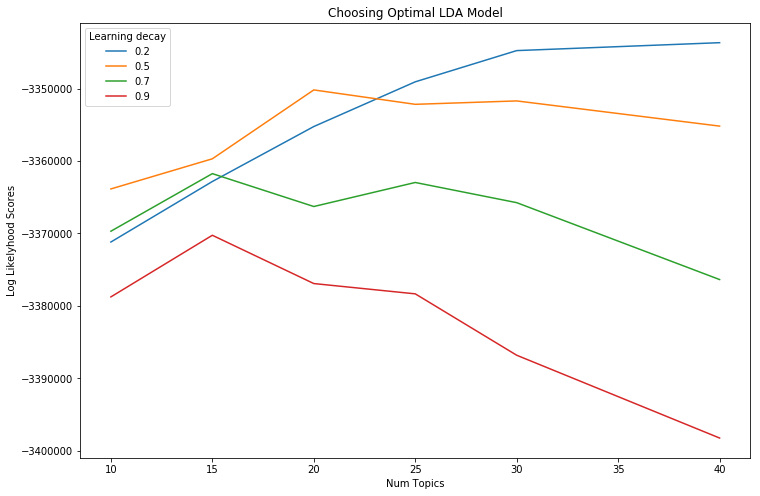

In [23]:
import matplotlib.pyplot as plt

# Get Log Likelyhoods from Grid Search Output
n_topics = [10, 15, 20, 25, 30,40]
log_likelyhoods_5 = [round(gscore.mean_validation_score) for gscore in model.grid_scores_ if gscore.parameters['learning_decay']==0.5]
log_likelyhoods_7 = [round(gscore.mean_validation_score) for gscore in model.grid_scores_ if gscore.parameters['learning_decay']==0.7]
log_likelyhoods_9 = [round(gscore.mean_validation_score) for gscore in model.grid_scores_ if gscore.parameters['learning_decay']==0.9]

# Show graph
plt.figure(figsize=(12, 8))
plt.plot(n_topics, log_likelyhoods_5, label='0.5')
plt.plot(n_topics, log_likelyhoods_7, label='0.7')
plt.plot(n_topics, log_likelyhoods_9, label='0.9')
plt.title("Choosing Optimal LDA Model")
plt.xlabel("Num Topics")
plt.ylabel("Log Likelyhood Scores")
plt.legend(title='Learning decay', loc='best')
plt.show()

In [ ]:
##dominant topic for document

In [24]:
# Create Document - Topic Matrix
lda_output = best_lda_model.transform(tf)

# column names
topicnames = ["Topic" + str(i) for i in range(model.best_params_['n_components'])]

# index names
docnames = ["Doc" + str(i) for i in range(len(docs))]

# Make the pandas dataframe
df_document_topic = pd.DataFrame(np.round(lda_output, 2), columns=topicnames, index=docnames)

# Get dominant topic for each document
dominant_topic = np.argmax(df_document_topic.values, axis=1)
df_document_topic['dominant_topic'] = dominant_topic

# Styling
def color_green(val):
    color = 'green' if val > .1 else 'black'
    return 'color: {col}'.format(col=color)

def make_bold(val):
    weight = 700 if val > .1 else 400
    return 'font-weight: {weight}'.format(weight=weight)

# Apply Style
df_document_topics = df_document_topic.style.applymap(color_green).applymap(make_bold)
df_document_topics

In [25]:

df_topic_distribution = df_document_topic['dominant_topic'].value_counts().reset_index(name="Num Documents")
df_topic_distribution.columns = ['Topic Num', 'Num Documents']
df_topic_distribution

,Topic Num,Num Documents
0,14,170
1,15,114
2,17,112
3,20,100
4,30,91
5,0,88
6,18,87
7,26,84
8,13,80
9,11,77


In [26]:
import pyLDAvis.sklearn

pyLDAvis.enable_notebook()
panel = pyLDAvis.sklearn.prepare(best_lda_model, tf,tf_vectorizer, mds='tsne')
panel

PreparedData(topic_coordinates=           Freq  cluster  topics           x           y
topic                                                   
14     7.946700        1       1  -17.678698  -22.608992
15     6.143997        1       2  -14.162292   13.514915
25     5.219951        1       3    3.522390   89.085190
11     4.939214        1       4   -4.162009   50.168926
0      4.730781        1       5   35.436188   86.366989
20     4.399956        1       6   50.637608    6.229718
26     4.060872        1       7   17.570362   16.312357
13     3.738296        1       8   34.376438   41.369740
17     3.662271        1       9    8.190394  -56.323414
30     3.637829        1      10  -43.090191   -0.831056
18     3.511934        1      11   38.716389  -76.946869
24     3.277254        1      12   66.766075   54.000610
19     3.119462        1      13   44.626049  -33.077606
22     2.989556        1      14  -44.093575   38.024776
16     2.975528        1      15   92.108871   22.668074
9      2.769467        1      16  -77.523544  -10.381763
32     2.759860        1      17   85.743141  -17.648100
38     2.504967        1      18  -83.725006   74.690094
4      2.457154        1      19  -42.137035  -49.555439
36     2.052198        1      20  -34.297985  119.548019
7      2.049995        1      21   19.021032  132.179001
23     1.935996        1      22   72.599785  106.559013
31     1.860279        1      23  120.258347   64.676682
3      1.798008        1      24  -89.486588  -50.157814
8      1.652851        1      25  -43.531891   79.153091
37     1.592966        1      26  -44.897533  -92.900948
27     1.540644        1      27   -4.628714  -92.660324
10     1.452821        1      28   79.680405  -62.145039
21     1.391048        1      29 -134.164932   47.246239
28     1.240797        1      30  -17.063499 -139.419388
29     1.035953        1      31  -87.034790   31.525913
2      1.013726        1      32   37.704712 -123.429985
6      0.802155        1      33  -96.589752 -104.909721
34     0.786552        1      34 -143.265625  -63.109978
33     0.767188        1      35  142.664093    0.657440
39     0.674514        1      36   97.941216 -115.154495
12     0.618027        1      37  136.801132  -61.062775
1      0.515621        1      38 -130.004044   -9.666212
5      0.370919        1      39  -97.686935  128.871811
35     0.002696        1      40   12.772494  -18.669830, topic_info=     Category         Freq          Term         Total  loglift  logprob
term                                                                    
558   Default  21200.00000         model  21200.000000  30.0000  30.0000
588   Default  30805.00000       network  30805.000000  29.0000  29.0000
452   Default  18433.00000         input  18433.000000  28.0000  28.0000
499   Default  19282.00000      learning  19282.000000  27.0000  27.0000
950   Default  12096.00000          unit  12096.000000  26.0000  26.0000
425   Default   8284.00000         image   8284.000000  25.0000  25.0000
26    Default  14486.00000     algorithm  14486.000000  24.0000  24.0000
637   Default   7415.00000       pattern   7415.000000  23.0000  23.0000
590   Default   8346.00000        neuron   8346.000000  22.0000  22.0000
375   Default  15870.00000      function  15870.000000  21.0000  21.0000
346   Default   7236.00000       feature   7236.000000  20.0000  20.0000
864   Default  10824.00000         state  10824.000000  19.0000  19.0000
106   Default   5110.00000          cell   5110.000000  18.0000  18.0000
123   Default   6413.00000         class   6413.000000  17.0000  17.0000
921   Default  13852.00000          time  13852.000000  16.0000  16.0000
592   Default   4077.00000          node   4077.000000  15.0000  15.0000
623   Default  10447.00000        output  10447.000000  14.0000  14.0000
409   Default   7482.00000        hidden   7482.000000  13.0000  13.0000
211   Default  12762.00000          data  12762.000000  12.0000  12.0000
589   Default  14632.00000    